In [1]:
import pandas as pd
import numpy as np
from pynm.pynm import PyNM
import seaborn as sns
import matplotlib.pyplot as plt

import patsy as pat
import statsmodels.api as sm
import time

This notebook demonstrates the usage of the approximate vs exact GP model using a large dataset.

## **Generate data**

In [2]:
def model(age, sex, offset):
    noise = np.random.normal(0, 0.1)
    return 0.001*age-0.00001*(age-50)**2+0.5 + noise - np.random.uniform(0, 0.3) * sex + offset


def model_prob(age, sex, offset):
    noise = np.random.normal(0, 0.1)
    return 0.001*age-0.00001*(age-50)**2+0.5 + noise - np.random.uniform(0, 0.3) * sex - 0.2 * np.random.uniform() + offset

def generate_data(group='PROB_CON', sample_size=1, n_sites=2, randseed=3):
    np.random.seed(randseed)
    n_sites = n_sites
    age_min = (np.random.rand(n_sites)*50).astype(int)
    sites = pd.DataFrame(data={'sex_ratio': np.random.rand(n_sites),
                               'prob_ratio': 0.5*np.random.rand(n_sites),
                               'age_min': age_min,
                               'age_max': (age_min+5+np.random.rand(n_sites)*50).astype(int),
                               'score_shift': np.random.randn(n_sites)/4,
                               'sample_size': (sample_size+np.random.rand(n_sites)*sample_size*10).astype(int)})

    participants = []
    for site in sites.iterrows():
        for participant in range(int(site[1]['sample_size'])):
            sex = np.random.binomial(1, site[1]['sex_ratio'])
            prob = np.random.binomial(1, site[1]['prob_ratio'])
            age = np.random.uniform(site[1]['age_min'], site[1]['age_max'])
            if prob:
                score = model_prob(age, sex, site[1]['score_shift'])
            else:
                score = model(age, sex, site[1]['score_shift'])
            participants.append([site[0], sex, prob, age, score])

    df = pd.DataFrame(participants, columns=['site', 'sex', 'group', 'age', 'score'])
    df.sex.replace({1: 'Female', 0: 'Male'}, inplace=True)
    if group == 'PROB_CON':
        df.group.replace({1: 'PROB', 0: 'CTR'}, inplace=True)
    return df

In [3]:
df = generate_data(n_sites=3,sample_size=100,randseed=100)
print('n subjects = {}'.format(df.shape[0]))

n subjects = 2488


## **Visualize data**

Text(0.5, 1.0, 'By sex')

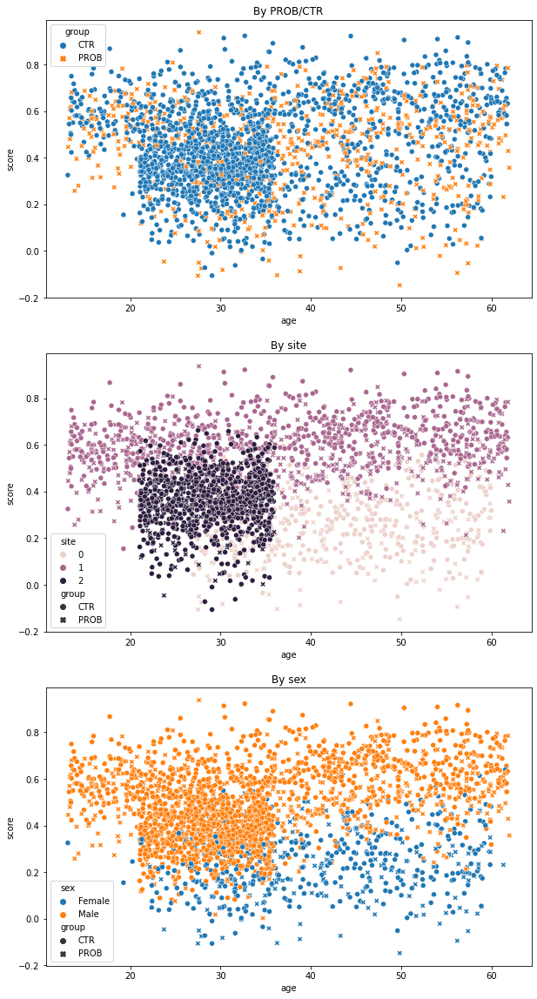

In [4]:
fig,ax = plt.subplots(3,1,figsize=(10,20))

sns.scatterplot(data=df, x='age', y='score', hue='group', style='group',ax=ax[0])
sns.scatterplot(data=df, x='age', y='score', hue='site', style='group',ax=ax[1])
sns.scatterplot(data=df, x='age', y='score', hue='sex', style='group',ax=ax[2])

ax[0].set_title('By PROB/CTR')
ax[1].set_title('By site')
ax[2].set_title('By sex')

## **PyNM - Normative Modeling**

In [5]:
#Initialize pynm w/ data and confounds
m = PyNM(df,'score','group',
            confounds = ['age','C(sex)','C(site)']) #multivarite confounds for GP model

Fitting model on full set of controls...


In [9]:
start = time.time()

#Run model
m.gp_normative_model(method='approx')

#Collect output
data_approx = m.data.copy()

print(time.time()-start)

Epoch: 100%|██████████| 20/20 [00:14<00:00,  1.36it/s]
14.923358917236328


In [10]:
start = time.time()

#Run model
m.gp_normative_model(method='exact')

#Collect output
data_exact = m.data.copy()

print(time.time()-start)

/home/harveyaa/Documents/normative_modeling/PyNM/pynm/pynm.py:500: Warning: Exact GP model with over 1000 data points requires large amounts of time and memory, continuing with exact model.
  "large amounts of time and memory, continuing with exact model.",Warning)
35.04820489883423


## **Visualize Normative Models**

Text(0.5, 1.0, 'Exact GP')

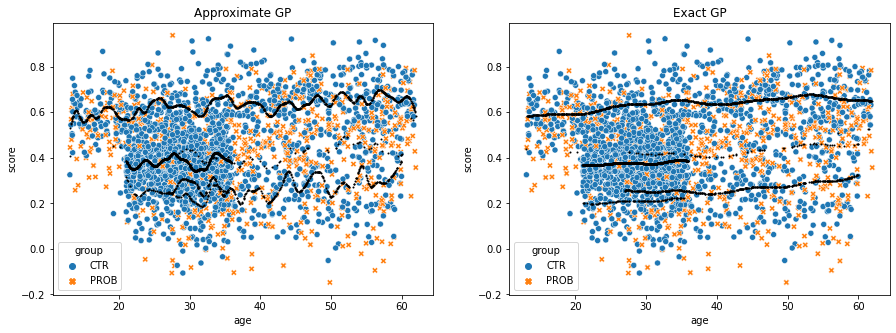

In [11]:
fig,ax = plt.subplots(1,2,figsize=(15,5))

for i in range(2):
    sns.scatterplot(data=m.data, x='age', y='score',
                             hue='group', style='group',ax=ax[i])

tmp_approx = data_approx.sort_values('age')
ax[0].scatter(tmp_approx['age'], tmp_approx['GP_nmodel_pred'],color='black',s=1)

tmp_exact = data_exact.sort_values('age')
ax[1].scatter(tmp_exact['age'], tmp_exact['GP_nmodel_pred'],color='black',s=1)

ax[0].set_title('Approximate GP')
ax[1].set_title('Exact GP')

Text(0.5, 1.0, 'Exact GP')

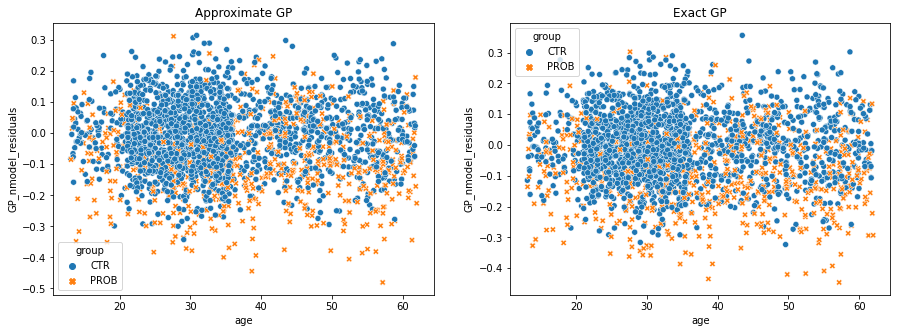

In [12]:
fig,ax = plt.subplots(1,2,figsize=(15,5))

sns.scatterplot(data=data_approx,x='age', y='GP_nmodel_residuals',hue='group',style='group',ax=ax[0])
sns.scatterplot(data=data_exact,x='age', y='GP_nmodel_residuals',hue='group',style='group',ax=ax[1])

ax[0].set_title('Approximate GP')
ax[1].set_title('Exact GP')

Text(0.5, 1.0, 'Exact GP')

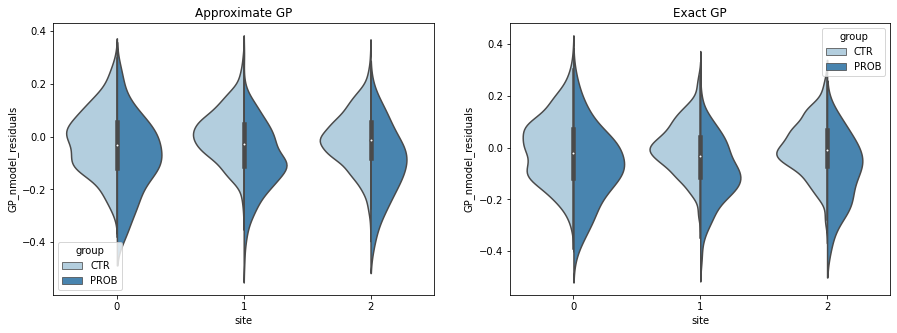

In [14]:
fig,ax = plt.subplots(1,2,figsize=(15,5))

sns.violinplot(x='site',y='GP_nmodel_residuals',data=data_approx,split=True,palette='Blues',hue='group',ax=ax[0])
sns.violinplot(x='site',y='GP_nmodel_residuals',data=data_exact,split=True,palette='Blues',hue='group',ax=ax[1])

ax[0].set_title('Approximate GP')
ax[1].set_title('Exact GP')

Text(0.5, 1.0, 'Exact GP')

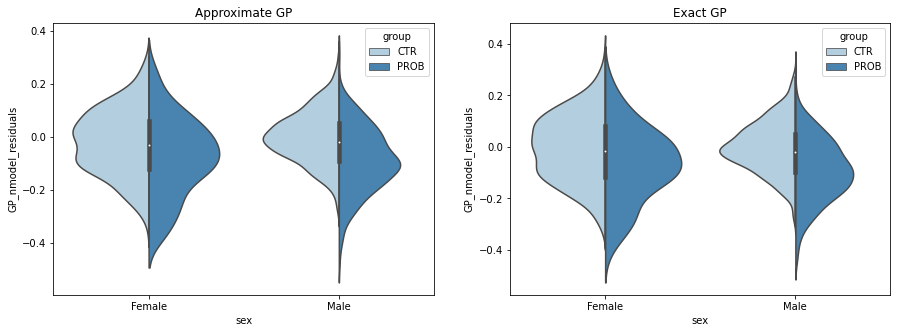

In [15]:
fig,ax = plt.subplots(1,2,figsize=(15,5))

sns.violinplot(x='sex',y='GP_nmodel_residuals',data=data_approx,split=True,palette='Blues',hue='group',ax=ax[0])
sns.violinplot(x='sex',y='GP_nmodel_residuals',data=data_exact,split=True,palette='Blues',hue='group',ax=ax[1])

ax[0].set_title('Approximate GP')
ax[1].set_title('Exact GP')

## Case-control

In [29]:
def case_control(df, group='group',score='score'):
    dmat = pat.dmatrix('C({})'.format(group), df, return_type='dataframe',NA_action='raise')
    results = sm.OLS(df[score],dmat).fit()
    return results.pvalues[1]

In [30]:
p_approx = case_control(data_approx,score='GP_nmodel_residuals')
p_exact = case_control(data_exact,score='GP_nmodel_residuals')

print('approx: p =', p_approx)
print('exact: p =', p_exact)

approx: p = 7.315307776519974e-57
exact: p = 7.010089694539498e-63


## XL

In [21]:
df_xl = generate_data(n_sites=3,sample_size=1000,randseed=100)
print('n subjects = {}'.format(df_xl.shape[0]))

n subjects = 24893


In [22]:
#Initialize pynm w/ data and confounds
m_xl = PyNM(df_xl,'score','group',
            confounds = ['age','C(sex)','C(site)']) #multivarite confounds for GP model

Fitting model on full set of controls...


In [23]:
start = time.time()

#Run model
m_xl.gp_normative_model(method='approx')

print(time.time()-start)

10.99it/s, loss=-.732]
Epoch: 100%|██████████| 20/20 [02:11<00:00,  6.56s/it]
132.7935950756073


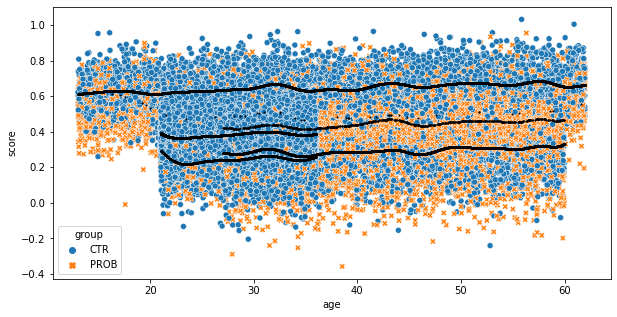

In [26]:
plt.figure(figsize=(10,5))

sns.scatterplot(data=m_xl.data, x='age', y='score',
                             hue='group', style='group')

tmp = m_xl.data.sort_values('age')
plt.scatter(tmp['age'], tmp['GP_nmodel_pred'],color='black',s=1)

<AxesSubplot:xlabel='age', ylabel='GP_nmodel_residuals'>

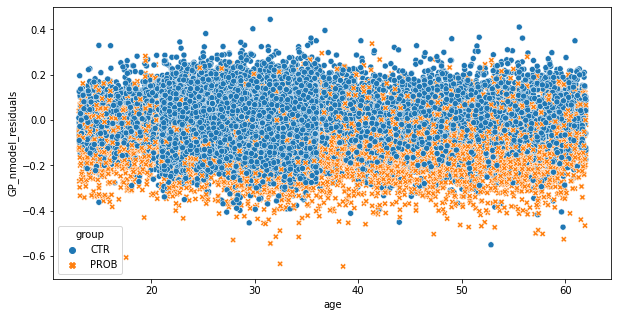

In [27]:
plt.figure(figsize=(10,5))

sns.scatterplot(data=m_xl.data, x='age', y='GP_nmodel_residuals',
                             hue='group', style='group')

In [32]:
p = case_control(m_xl.data, score='GP_nmodel_residuals')

print('XL: p = ', p)

XL: p =  0.0
